In [1]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from pathlib import Path

In [2]:
county_shpfile_path = Path('US_COUNTY_SHPFILE/US_county_cont.shp')
us_county = gpd.read_file(county_shpfile_path)
pipeline_shpfile_path = Path('pipeline_shapefile/NaturalGas_InterIntrastate_Pipelines_US_EIA.shp')
pipelines = gpd.read_file(pipeline_shpfile_path)

c:\Users\Ursuline\Miniconda\envs\p4gr-env\lib\site-packages\pyogrio\core.py:35: RuntimeWarning: Could not detect GDAL data files.  Set GDAL_DATA environment variable to the correct path.
  _init_gdal_data()


In [3]:
southwestern_state_list = ['Texas', 'New Mexico','Arizona', 'California'] 
southwestern_states = us_county[us_county['STATE_NAME'].isin(southwestern_state_list)]

In [4]:
southwestern_states.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [5]:
pipelines.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [6]:
pipelines.shape

(32892, 5)

<Axes: >

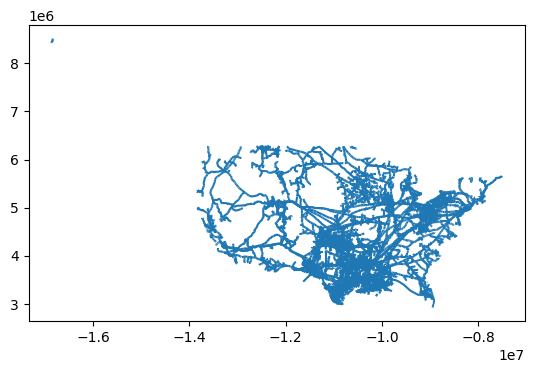

In [7]:
pipelines.plot()

In [8]:
southwestern_states = southwestern_states.to_crs(pipelines.crs)

<Axes: >

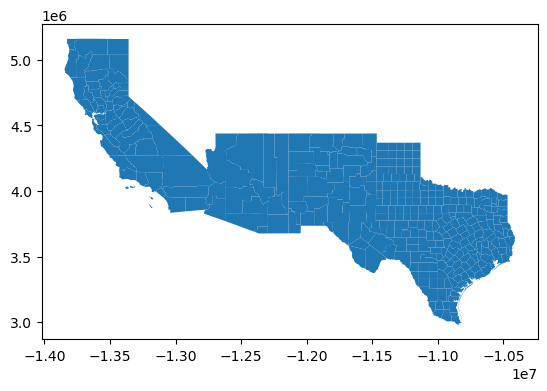

In [9]:
southwestern_states.plot()

In [10]:
southwestern_states = southwestern_states.dissolve(by='STATE_NAME')

<Axes: >

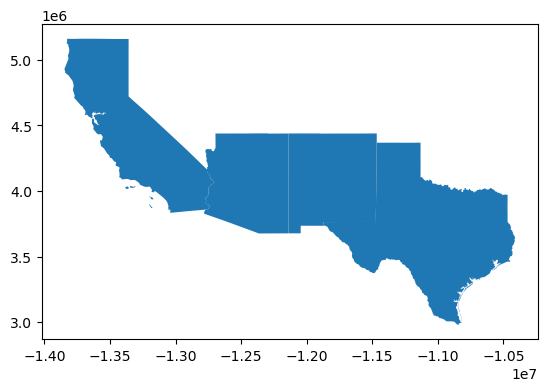

In [11]:
southwestern_states.plot()

In [12]:
pipelines.shape

(32892, 5)

<Axes: >

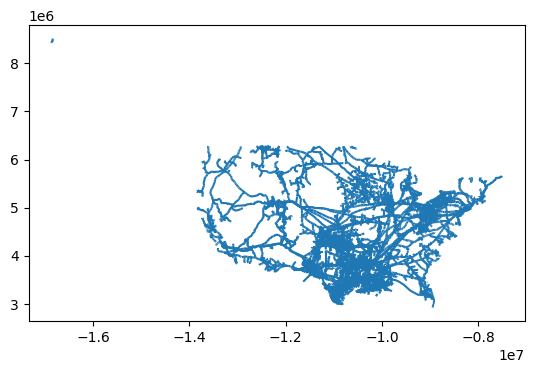

In [13]:
pipelines.plot()

<Axes: >

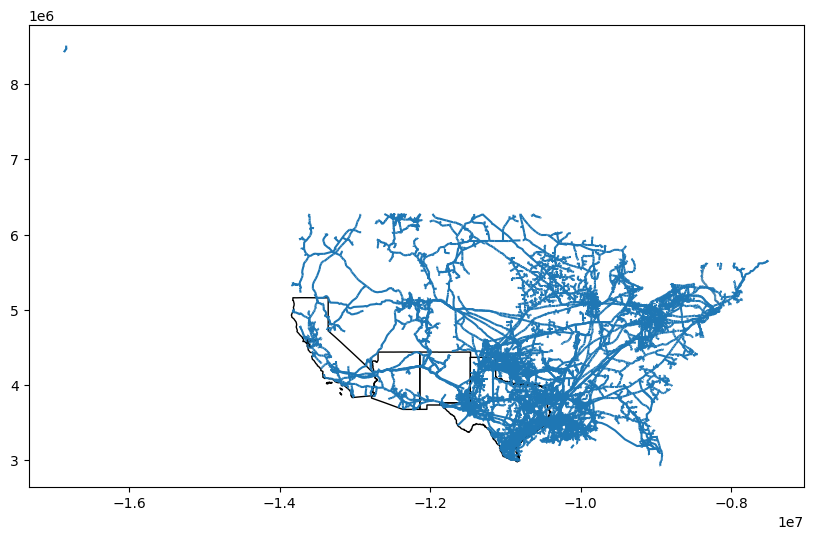

In [14]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
pipelines.plot(ax=ax)

In [15]:
southwestern_pipelines = gpd.overlay(pipelines, southwestern_states, how="intersection")

<Axes: >

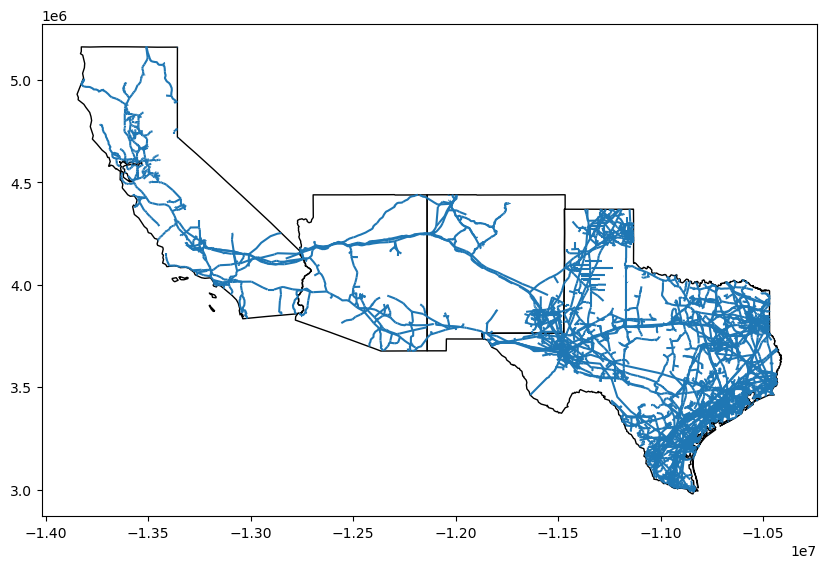

In [16]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
southwestern_pipelines.plot(ax=ax)

In [18]:
southwest_i_10_path = Path('southwest_i_10_shapefile/southwest_i_10.shp')
i_10 = gpd.read_file(southwest_i_10_path)

In [19]:
from shapely.geometry import Point

In [20]:
los_angeles = Point(-118.2426,34.0549)
houston = Point(-95.3701,29.7601)
hou_la = gpd.GeoDataFrame(geometry = [houston, los_angeles])
hou_la = hou_la.set_crs("EPSG:4326", inplace=True)

In [21]:
hou_la.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [22]:
hou_la = hou_la.to_crs(southwestern_states.crs)

In [23]:
hou_la.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [24]:
i_10 = i_10.to_crs(pipelines.crs)

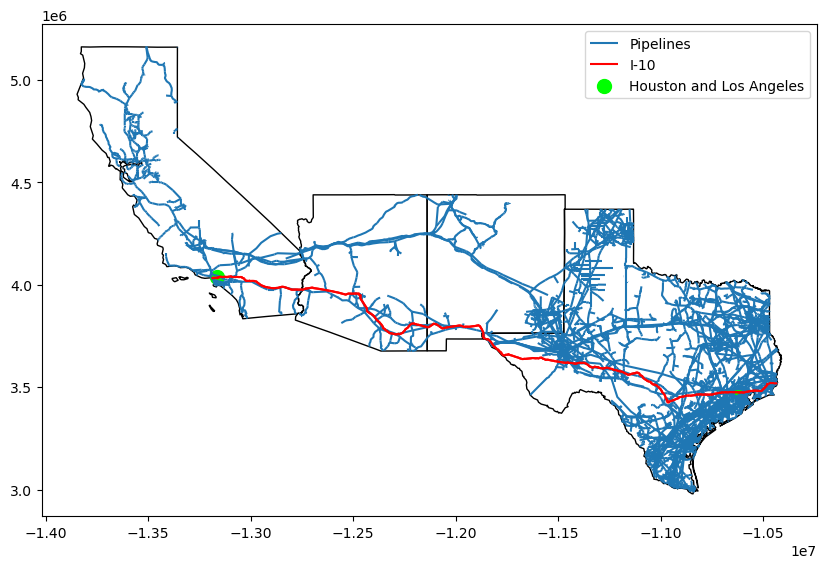

In [25]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
southwestern_pipelines.plot(ax=ax, label = "Pipelines")
i_10.plot(ax=ax, color='red', label = 'I-10')
hou_la.plot(ax=ax, color='lime', markersize=100, label = "Houston and Los Angeles")
plt.legend()



In [26]:
i_10_buffer = i_10.copy()
i_10_buffer["geometry"] = i_10.geometry.buffer(100000)

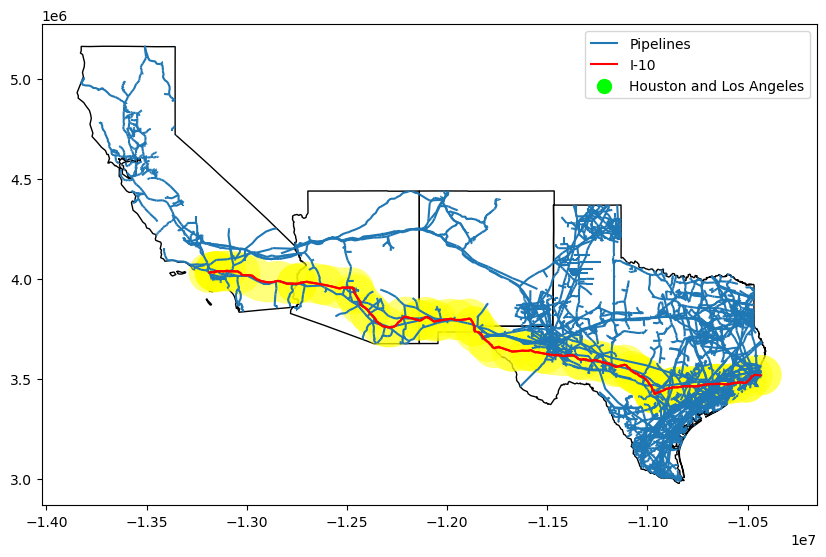

In [27]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
southwestern_pipelines.plot(ax=ax, label = "Pipelines")
i_10.plot(ax=ax, color='red', label = 'I-10')
hou_la.plot(ax=ax, color='lime', markersize=100, label = "Houston and Los Angeles")
i_10_buffer.plot(ax=ax, color='yellow', alpha=0.3)
plt.legend()

In [28]:
southwestern_pipelines.shape

(9802, 13)

In [29]:
southwestern_pipelines.columns

Index(['TYPEPIPE', 'Operator', 'Status', 'Shape_Leng_1', 'OBJECTID', 'NAME',
       'STATE_FIPS', 'CNTY_FIPS', 'FIPS', 'SQMI', 'Shape_Leng_2', 'Shape_Area',
       'geometry'],
      dtype='object')

In [30]:
pipeline_pd = pd.DataFrame(southwestern_pipelines)

In [31]:
buffered_pipelines = gpd.overlay(pipelines, i_10_buffer, how="intersection")

C:\Users\Ursuline\AppData\Local\Temp\ipykernel_5880\1053425659.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([f"{int(x / 1000)} km" for x in x_ticks])
C:\Users\Ursuline\AppData\Local\Temp\ipykernel_5880\1053425659.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y / 1000)} km" for y in y_ticks])


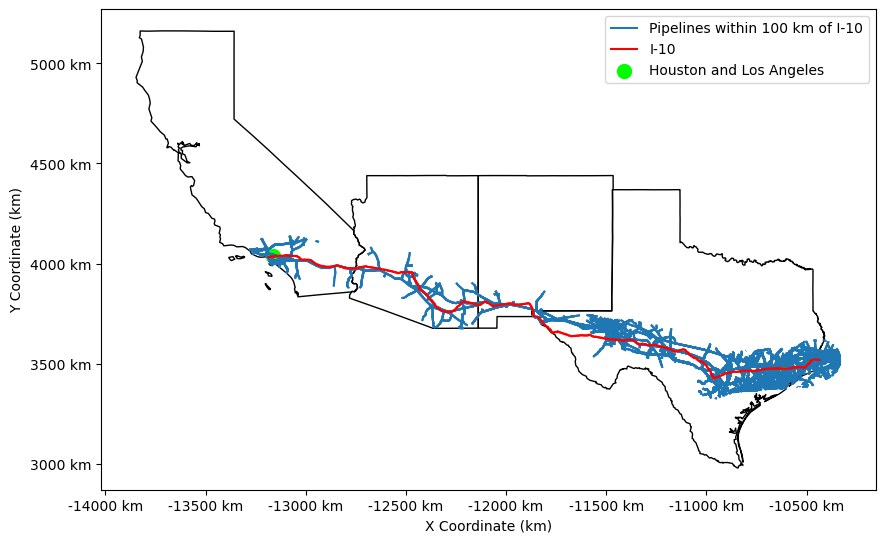

In [32]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
x_ticks = ax.get_xticks()  
y_ticks = ax.get_yticks()
ax.set_xticklabels([f"{int(x / 1000)} km" for x in x_ticks])
ax.set_yticklabels([f"{int(y / 1000)} km" for y in y_ticks])
ax.set_xlabel("X Coordinate (km)")
ax.set_ylabel("Y Coordinate (km)")
buffered_pipelines.plot(ax=ax, label = "Pipelines within 100 km of I-10")
i_10.plot(ax=ax, color='red', label = 'I-10')
hou_la.plot(ax=ax, color='lime', markersize=100, label = "Houston and Los Angeles")
plt.legend()


In [33]:
buffered_pipelines.explore()

In [35]:
county_center_path = Path('county_centers_shapefile/county_centers.shp')
county_centers = gpd.read_file(county_center_path)
county_centers = county_centers.to_crs(pipelines.crs)

In [36]:
overlapping_county_centers = gpd.overlay(county_centers, southwestern_states, how="intersection")

C:\Users\Ursuline\AppData\Local\Temp\ipykernel_5880\1743770179.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([f"{int(x / 1000)} km" for x in x_ticks])
C:\Users\Ursuline\AppData\Local\Temp\ipykernel_5880\1743770179.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y / 1000)} km" for y in y_ticks])


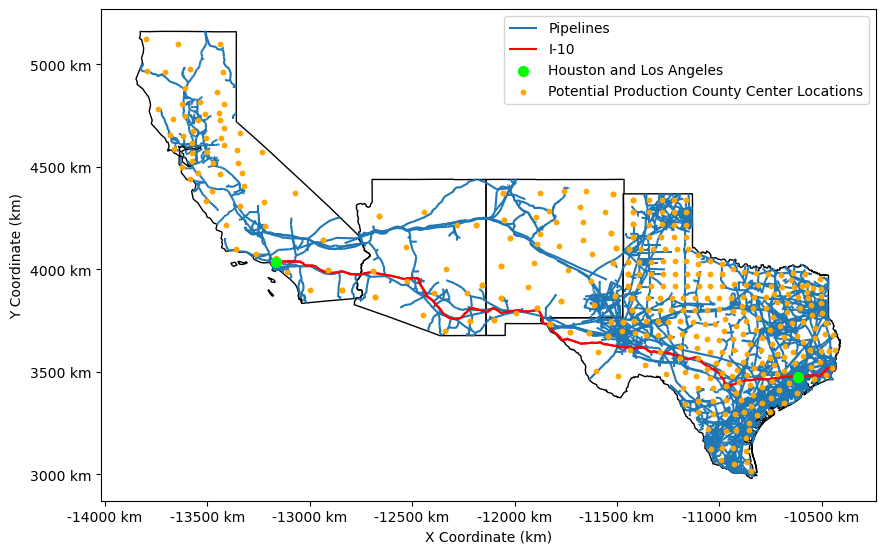

In [37]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
x_ticks = ax.get_xticks()  # Get x-axis tick positions
y_ticks = ax.get_yticks()
ax.set_xticklabels([f"{int(x / 1000)} km" for x in x_ticks])
ax.set_yticklabels([f"{int(y / 1000)} km" for y in y_ticks])
ax.set_xlabel("X Coordinate (km)")
ax.set_ylabel("Y Coordinate (km)")
southwestern_pipelines.plot(ax=ax, label = "Pipelines", zorder=1)
i_10.plot(ax=ax, color='red', label = 'I-10', zorder=2)
hou_la.plot(ax=ax, color='lime', markersize=50, label = "Houston and Los Angeles", zorder=4)
overlapping_county_centers.plot(ax=ax, color='orange', label = "Potential Production County Center Locations", markersize=10, zorder=3)
plt.legend()

In [38]:
pipelines.size

164460

In [39]:
protected_lands = gpd.read_file(Path("sw_protected_lands_shapefile/sw_protected_lands.shp"))

In [42]:
protected_lands = protected_lands.to_crs(overlapping_county_centers.crs)

<Axes: >

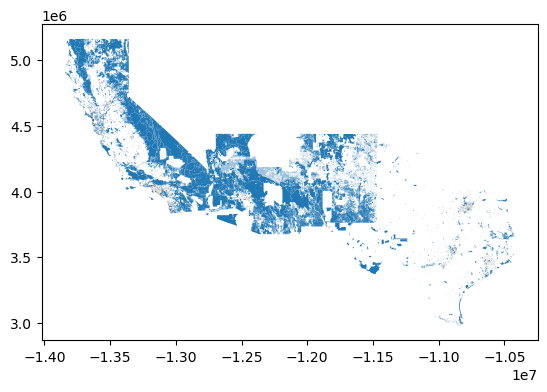

In [44]:
protected_lands.plot()

In [49]:
not_protected_county_centers = gpd.overlay(overlapping_county_centers, protected_lands, how="difference")
protected_county_centers = gpd.overlay(overlapping_county_centers, protected_lands, how="intersection")

<Axes: >

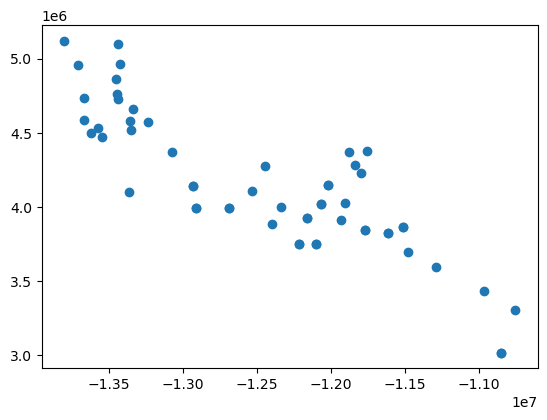

In [50]:
protected_county_centers.plot()

<Axes: >

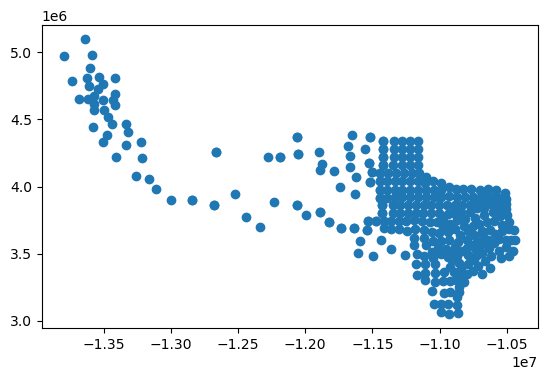

In [52]:
not_protected_county_centers.plot()

C:\Users\Ursuline\AppData\Local\Temp\ipykernel_5880\4002824578.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([f"{int(x / 1000)} km" for x in x_ticks])
C:\Users\Ursuline\AppData\Local\Temp\ipykernel_5880\4002824578.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(y / 1000)} km" for y in y_ticks])


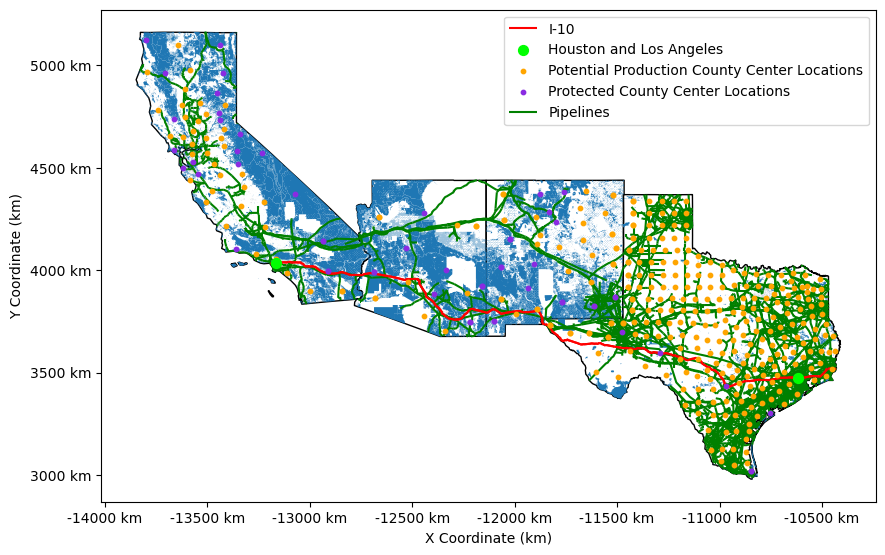

In [57]:
ax = southwestern_states.plot(edgecolor='black', facecolor='none', figsize=(10,10))
x_ticks = ax.get_xticks()  # Get x-axis tick positions
y_ticks = ax.get_yticks()
ax.set_xticklabels([f"{int(x / 1000)} km" for x in x_ticks])
ax.set_yticklabels([f"{int(y / 1000)} km" for y in y_ticks])
ax.set_xlabel("X Coordinate (km)")
ax.set_ylabel("Y Coordinate (km)")
#southwestern_pipelines.plot(ax=ax, label = "Pipelines", zorder=1)
i_10.plot(ax=ax, color='red', label = 'I-10', zorder=3)
hou_la.plot(ax=ax, color='lime', markersize=50, label = "Houston and Los Angeles", zorder=6)
not_protected_county_centers.plot(ax=ax, color='orange', label = "Potential Production County Center Locations", markersize=10, zorder=4)
protected_lands.plot(ax=ax, zorder=1)
protected_county_centers.plot(ax=ax, color='blueviolet', label = "Protected County Center Locations", markersize=10, zorder=5)
southwestern_pipelines.plot(ax=ax, label = "Pipelines", color='green', zorder=2)
plt.legend()